# OFT2 Analysis

The goal of this notebook is to produce several plots and data tables using the mouse coordinates extracted from video using DeepLabCut

Results include
- Distance traveled
- Heatmaps (where mice are spending their time)
- Representative plots (tracks of mice throughout the video)
- Time in inner area (defined as 7cm from wall)

--- 
Contact Details
- Code author: Andre Telfer (andretelfer@cmail.carleton.ca)    
- Primary contact: Argel Aguilar-Valles (Argel.AguilaValles@Carleton.ca)     
- Associated Lab: https://carleton.ca/neuroscience/profile/argel-aguilar-valles/    

---
This notebook can be run using the provided docker image, or by manually installing the requires packages. The dataset itself is not yet public. 

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cv2 
import re
import seaborn as sns
import statsmodels.api as sm
import json

from skimage.draw import polygon
from ruamel.yaml import YAML
from IPython.display import display, HTML, Image
from statsmodels.formula.api import ols
from tqdm.notebook import tqdm
from pathlib import Path
from scipy.stats import gaussian_kde
from skimage.transform import resize

plt.rcParams['font.size'] = 16

## Data Configuration
Organization of the datafiles and experiment-specific details

In [2]:
CONFIG_PATH = Path("/home/jovyan/data/oft-inhibitor/v2/config.yaml")
assert CONFIG_PATH.exists()

with open(CONFIG_PATH, 'r') as fp:
    config = YAML().load(fp)
    
! cat {CONFIG_PATH}

# Dataset name
dataset: avlab-inhibitor-oft

# Relative or global paths to data
videos: videos
dlc-destfolder: mouse-labels
manual-registrations-file: registrations.csv

# Shape of the Open Field Test Box
box-shape: 
  height: 480
  width: 380

# DLC pcutoff
pcutoff: 0.9

# Time cutoff for analysis in seconds
time-cutoff: 600 

# Frames per second in each video
fps: 30


In [3]:
# Path to the videos
VIDEO_DIR = CONFIG_PATH.parent / config['videos']
videos = list(VIDEO_DIR.glob('*.mp4'))

# Path to the DeepLabCut labels
DLC_DESTFOLDER = CONFIG_PATH.parent / config['dlc-destfolder']

# Manual corner registrations (done using Napari)
REGISTRATION_FILE = CONFIG_PATH.parent / config['manual-registrations-file']

# Cutoff time
CUTOFF_TIME = config['time-cutoff'] * config['fps']

# Where the results should go
RESULTS = Path("/home/jovyan/shared/results") / config['dataset']
if not RESULTS.exists():
    RESULTS.mkdir(parents=True)

In [4]:
# Points to align the manual registrations with
h = config['box-shape']['height']
w = config['box-shape']['width']
box_shape = [h, w]
ground_truth_box_corners = np.array([
    [0, 0],
    [0, w],
    [h, w],
    [h, 0]
], dtype=np.float32)


## Load a sample frame from each video
Here we display what the videos look like before we apply any corrections, note the changes in box position inside each frame. In some cases, the size in the image also changes (e.g. when the camera is further/closer).

Loading frames:   0%|          | 0/96 [00:00<?, ?it/s]

Creating individual plots:   0%|          | 0/96 [00:00<?, ?it/s]

Creating summary plot:   0%|          | 0/96 [00:00<?, ?it/s]

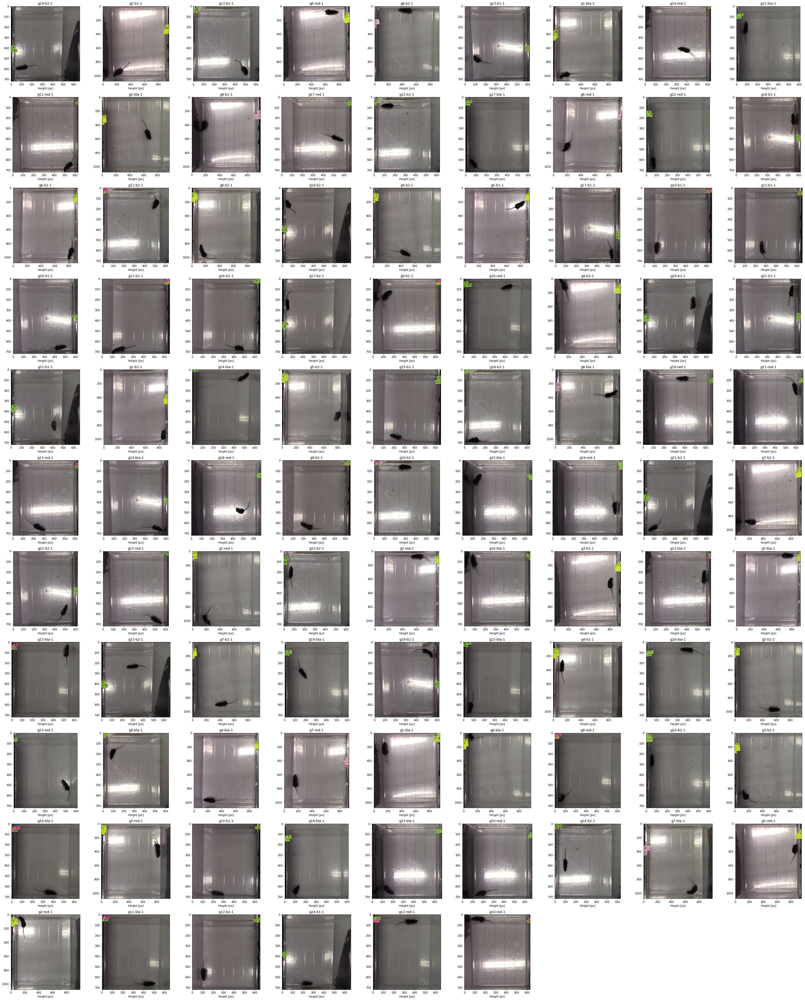

In [5]:
def get_frame(video, frame_index):
    cap = cv2.VideoCapture(str(video))
    cap.set(cv2.CAP_PROP_POS_FRAMES, frame_index)
    ret, frame = cap.read()
    return np.flip(frame, 2)
    
columns = int(np.sqrt(len(videos)))
rows = int(np.ceil(len(videos) / columns))
gs = plt.GridSpec(rows, columns)
frame_pos = 60 * 5
frames = [get_frame(video, frame_pos) for video in tqdm(videos, position=0, leave=True, desc="Loading frames")]

# Plot each frame individually
for idx in tqdm(range(len(frames)), position=0, leave=True, desc="Creating individual plots"):
    plt.figure(figsize=(8,8))
    plt.imshow(frames[idx])
    filename, ext = videos[idx].parts[-1].split('.')
    
    savepath = RESULTS / 'reference-plots' / 'original-frames' / f"{filename}.png"
    if not savepath.parent.exists():
        savepath.parent.mkdir(parents=True)
    
    plt.title(filename)
    plt.xlabel("Width [px]")
    plt.xlabel("Height [px]")
    plt.savefig(savepath)
    plt.close()
    
# Create a summary plot
base_size=5
max_h, max_w, _ = np.max(np.array([frame.shape for frame in frames]), axis=0)
width_height_ratio = max_w/max_h
fig = plt.figure(figsize=(columns*base_size*width_height_ratio, rows*base_size*width_height_ratio))

for idx in tqdm(range(len(frames)), position=0, leave=True, desc="Creating summary plot"):
    plt.subplot(gs[idx])
    plt.imshow(frames[idx])
    filename, ext = videos[idx].parts[-1].split('.')
    plt.title(filename)
    plt.xlabel("Width [px]")
    plt.xlabel("Height [px]")
    
plt.tight_layout()
plt.savefig(RESULTS / 'all-original-videos.png')
plt.show()

## Visualize Manual Corner Registrations
Here we plot the manually registered corners, which were done using [napari](https://napari.org/), over the image.


Creating individual plots:   0%|          | 0/96 [00:00<?, ?it/s]

Creating summary plot:   0%|          | 0/96 [00:00<?, ?it/s]

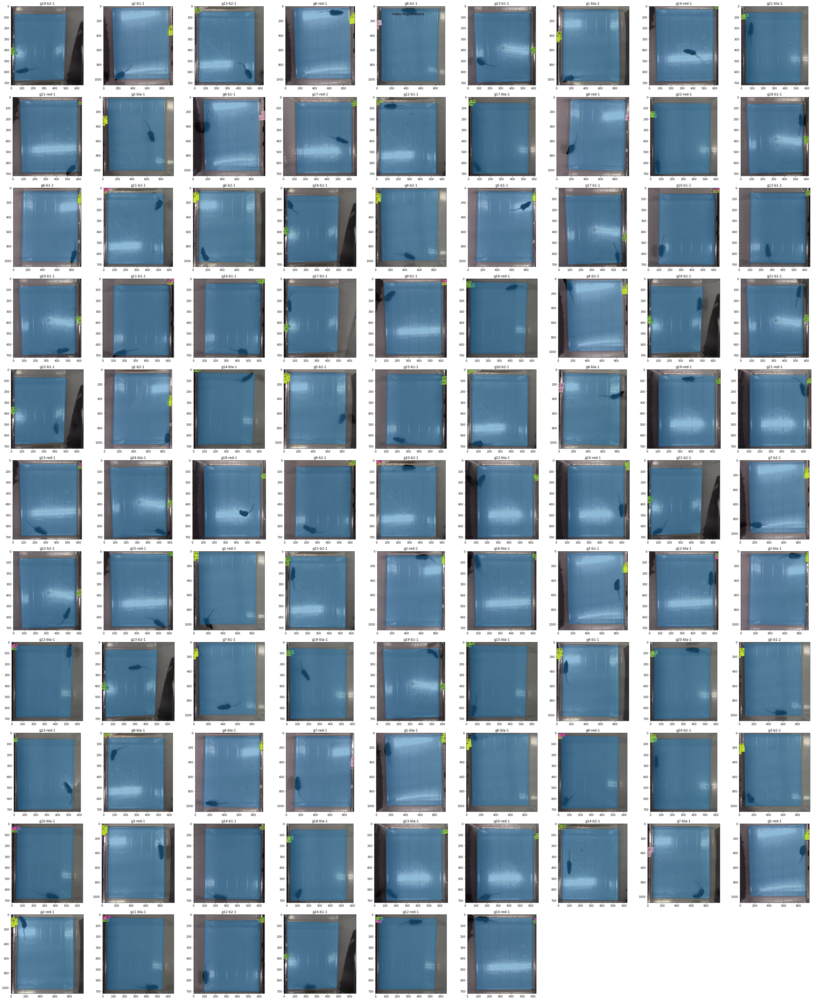

In [6]:
registration_df = pd.read_csv(REGISTRATION_FILE)
registration_df = registration_df.rename(columns={'axis-1': 'y', 'axis-2': 'x'})
registration_groups = registration_df.groupby('id')
    
# Plot each frame individually
for idx in tqdm(range(len(frames)), position=0, leave=True, desc="Creating individual plots"):
    plt.figure(figsize=(8,8))
    plt.imshow(frames[idx])
    filename, ext = videos[idx].parts[-1].split('.')
    src = registration_groups.get_group(filename)[['x', 'y']].values.astype(np.float32)
    poly = plt.Polygon(src, alpha=0.3)
    plt.gca().add_patch(poly)
    savepath = RESULTS / 'reference-plots' / 'registration' / f"{filename}.png"
    if not savepath.parent.exists():
        savepath.parent.mkdir(parents=True)
    
    plt.title(filename)
    plt.savefig(savepath)
    plt.close()
    
# Create a summary plot
base_size=5
fig = plt.figure(figsize=(columns*base_size*width_height_ratio, rows*base_size*width_height_ratio))
plt.suptitle("Video Registrations")
for idx in tqdm(range(len(frames)), position=0, leave=True, desc="Creating summary plot"):
    plt.subplot(gs[idx])
    plt.imshow(frames[idx])
    filename, ext = videos[idx].parts[-1].split('.')
    src = registration_groups.get_group(filename)[['x', 'y']].values.astype(np.float32)
    poly = plt.Polygon(src, alpha=0.5)
    plt.gca().add_patch(poly)
    plt.title(filename)
    

plt.tight_layout()
plt.savefig(RESULTS / 'all-registrations.png')

## Show Corrected Frames
Here we normalize the videos using the registered points. Notice that the position of the box inside the videos now appears to match up, and all of the boxes appear to be the same size.

Find homogeneous transforms:   0%|          | 0/96 [00:00<?, ?it/s]

Correct frames:   0%|          | 0/96 [00:00<?, ?it/s]

Creating individual plots:   0%|          | 0/96 [00:00<?, ?it/s]

Creating summary plot:   0%|          | 0/96 [00:00<?, ?it/s]

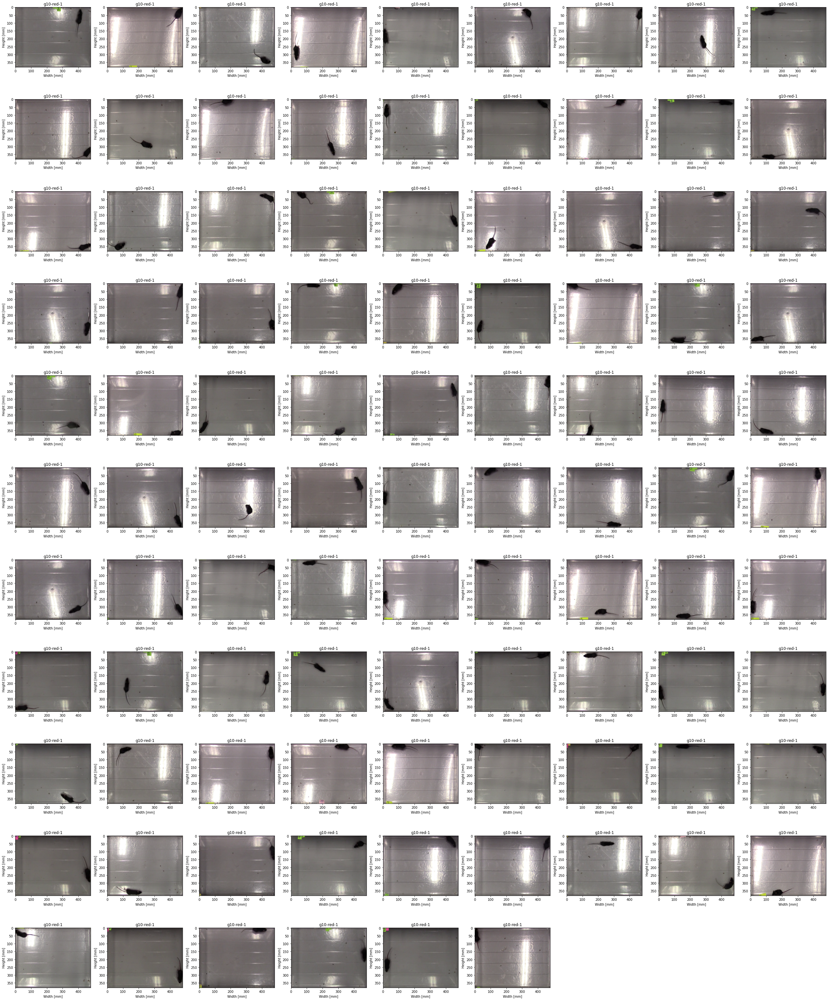

In [7]:
def get_perspective_transform(video):
    filename, ext = video.parts[-1].split('.')
    src = registration_groups.get_group(filename)[['x', 'y']].values.astype(np.float32)
    M = cv2.getPerspectiveTransform(src, ground_truth_box_corners)
    return M
    
def create_video_grid(videos, scale=0.5, frame_pos=900):
    """Aggregate a VideoSet into a single summary image"""
    columns = int(np.sqrt(len(videos)))
    rows = int(np.ceil(len(videos) / columns))
    
    frames = []
    for video in tqdm(videos, position=0, leave=True, desc="Loading frames"):
        M = get_perspective_transform(video)
        frames.append(get_corrected_frame(video, frame_pos, M))
        
# Find the homogeneous transforms
homogeneous_transforms = []
for idx in tqdm(range(len(frames)), position=0, leave=True, desc="Find homogeneous transforms"):
    M = get_perspective_transform(videos[idx])
    homogeneous_transforms.append(M)
    
# Correct the frames
corrected_frames = []
for idx in tqdm(range(len(frames)), position=0, leave=True, desc="Correct frames"):
    frame = frames[idx]
    M = homogeneous_transforms[idx]
    corrected_frames.append(cv2.warpPerspective(frame, M, box_shape))

# Plot each frame individually
for idx in tqdm(range(len(frames)), position=0, leave=True, desc="Creating individual plots"):
    plt.figure(figsize=(8,8))
    plt.imshow(corrected_frames[idx])
    savepath = RESULTS / 'reference-plots' / 'corrected-frames' / f"{filename}.png"
    if not savepath.parent.exists():
        savepath.parent.mkdir(parents=True)
    
    plt.xlabel("Width [mm]")
    plt.ylabel("Height [mm]")
    plt.title(filename)
    plt.savefig(savepath)
    plt.close()
    
# Create a summary plot
base_size=5
width_height_ratio = w/h
fig = plt.figure(figsize=(columns*base_size*width_height_ratio, rows*base_size*width_height_ratio))
for idx in tqdm(range(len(frames)), position=0, leave=True, desc="Creating summary plot"):
    plt.subplot(gs[idx])
    plt.imshow(corrected_frames[idx])
    plt.xlabel("Width [mm]")
    plt.ylabel("Height [mm]")
    plt.title(filename)

plt.tight_layout()
plt.savefig(RESULTS / 'all-registrations.png')

## Transform points

Creating individual plots:   0%|          | 0/96 [00:00<?, ?it/s]

Creating summary plot:   0%|          | 0/96 [00:00<?, ?it/s]

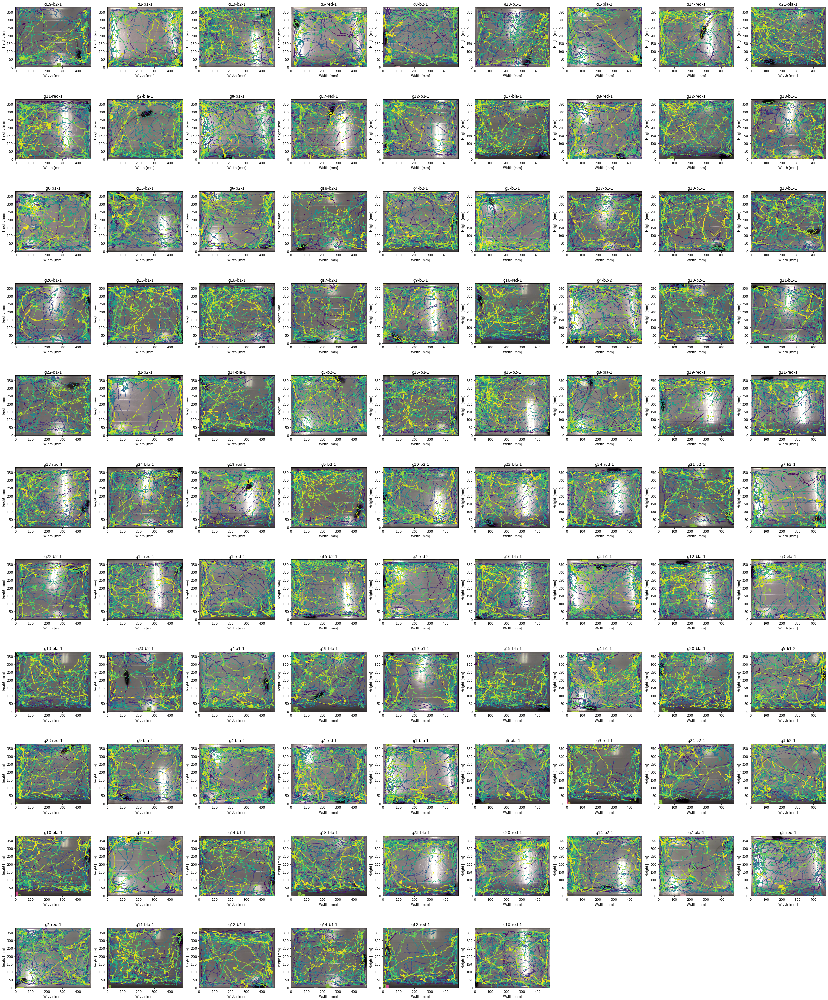

In [8]:
def transform_dataframe_to_perspective(df, M):
    """Transform the coordinate dataframes to be in the box's frame of reference"""
    df = df.copy().dropna()
    idx = pd.IndexSlice
    x = df.loc[:, idx[:, :, "x"]]
    y = df.loc[:, idx[:, :, "y"]]
    x = x.stack(dropna=False).stack(dropna=False)
    y = y.stack(dropna=False).stack(dropna=False)

    tx, ty, v = M @ np.c_[x, y, np.ones_like(x)].T
    tx = tx / v
    ty = ty / v

    tx = pd.DataFrame(tx, index=x.index, columns=x.columns).unstack().unstack()
    ty = pd.DataFrame(ty, index=y.index, columns=y.columns).unstack().unstack()

    # Update multi index columns to match
    df.loc[:, pd.IndexSlice[:, :, "x"]] = tx
    df.loc[:, pd.IndexSlice[:, :, "y"]] = ty
    return df
    
def remove_low_confidence_points(df):
    low_confidence = df.xs("likelihood", level="coords", axis=1) < config['pcutoff']
    return df.where(~low_confidence)
            
def get_df(video):
    filename, ext = video.parts[-1].split('.')
    dlc_file = next(DLC_DESTFOLDER.glob(f"{filename}DLC*.h5"))
    df = pd.read_hdf(dlc_file)
    return df
    
def plot_tracks(frame, centroid, filename):
    plt.imshow(frame)
    c = np.arange(centroid.shape[0])
    plt.scatter(centroid.x, centroid.y, c=c, s=1)
    w, h = box_shape
    plt.xlim(0, w)
    plt.ylim(0, h)
    plt.xlabel("Height [mm]")
    plt.ylabel("Width [mm]")
    plt.title(filename)
    
# Plot each frame individually
for idx in tqdm(range(len(frames)), position=0, leave=True, desc="Creating individual plots"):
    M = homogeneous_transforms[idx]
    df = get_df(videos[idx])
    df = remove_low_confidence_points(df)
    df = transform_dataframe_to_perspective(df, M)
    centroid = df.groupby(level='coords', axis=1).mean()[['x', 'y']]
    
    filename, ext = videos[idx].parts[-1].split('.')
    plt.imshow(corrected_frames[idx])
    c = np.arange(centroid.shape[0])
    plt.scatter(centroid.x, centroid.y, c=c, s=1)
    w, h = box_shape
    plt.xlim(0, w)
    plt.ylim(0, h)
    plt.ylabel("Height [mm]")
    plt.xlabel("Width [mm]")
    plt.title(filename)
    
    savepath = RESULTS / 'reference-plots' / 'corrected-frames-with-tracks' / f"{filename}.png"
    if not savepath.parent.exists():
        savepath.parent.mkdir(parents=True)
    
    plt.title(filename)
    plt.savefig(savepath)
    plt.close()
    
# Create a summary plot
base_size=5
fig = plt.figure(figsize=(columns*base_size*width_height_ratio, rows*base_size*width_height_ratio))
for idx in tqdm(range(len(frames)), position=0, leave=True, desc="Creating summary plot"):
    plt.subplot(gs[idx])
    M = homogeneous_transforms[idx]
    df = get_df(videos[idx])
    df = remove_low_confidence_points(df)
    df = transform_dataframe_to_perspective(df, M)
    centroid = df.groupby(level='coords', axis=1).mean()[['x', 'y']]
    
    filename, ext = videos[idx].parts[-1].split('.')
    plt.imshow(corrected_frames[idx])
    c = np.arange(centroid.shape[0])
    plt.scatter(centroid.x, centroid.y, c=c, s=1)
    w, h = box_shape
    plt.xlim(0, w)
    plt.ylim(0, h)
    plt.ylabel("Height [mm]")
    plt.xlabel("Width [mm]")
    plt.title(filename)
    
plt.tight_layout()
plt.savefig(RESULTS / 'all-registrations.png')

## Get Distances

In [9]:
rows = []
for idx in tqdm(range(len(videos))):
    video = videos[idx]
    M = homogeneous_transforms[idx]
    df = get_df(video)
    df = remove_low_confidence_points(df)
    df = transform_dataframe_to_perspective(df, M)
    
    centroid = df.groupby(level='coords', axis=1).mean()[['x', 'y']]
    centroid = centroid.iloc[:CUTOFF_TIME] # Crop for time
    deltas = centroid.diff().dropna()
    distance = np.sum(np.linalg.norm(deltas.values, axis=1))
    
    filename, ext = video.parts[-1].split('.')
    
    m = re.match("g(?P<group>\d+)-(?P<treatment>\w+?)-.*", filename)
    
    rows.append({
        'id': filename,
        'distance': distance,
        **m.groupdict()
    })
    
distances = pd.DataFrame(rows)
distances['sex'] = distances.group.apply(lambda x: 'm' if int(x) <= 12 else 'f')
distances.to_csv(RESULTS / 'distances.csv', index=False)
distances.sample(3)

  0%|          | 0/96 [00:00<?, ?it/s]

,id,distance,group,treatment,sex
67,g19-b1-1,42951.806846,19,b1,f
89,g5-red-1,46583.213995,5,red,m
92,g12-b2-1,43085.100016,12,b2,m


### Quick data look
ANOVA plot (*assumptions such as distribution shape or homogeneity not checked here)

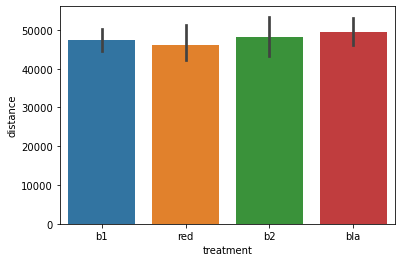

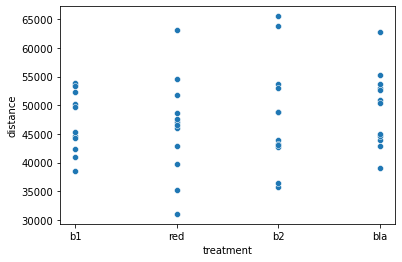

,sum_sq,df,F,PR(>F)
C(treatment),6.906397e+07,3.0,0.391184,0.759924
Residual,2.589415e+09,44.0,NaN,NaN


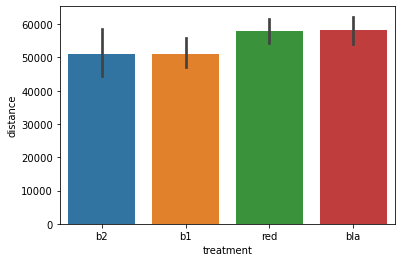

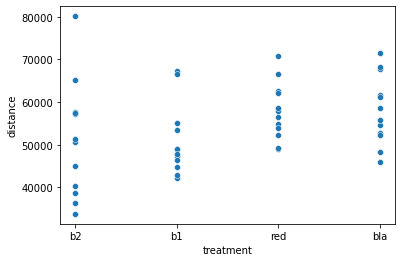

,sum_sq,df,F,PR(>F)
C(treatment),5.810159e+08,3.0,2.150549,0.107438
Residual,3.962507e+09,44.0,NaN,NaN


In [10]:
for sex in 'mf':
    if sex == 'm':
        display(HTML(f"<h2>Male</h2>"))
    else:
        display(HTML(f"<h2>Female</h2>"))
        
    sns.barplot(data=distances[distances.sex==sex], x='treatment', y='distance')
    plt.show()
    sns.scatterplot(data=distances[distances.sex==sex], x='treatment', y='distance')
    plt.show()
    model = ols('distance ~ C(treatment)', data=distances[distances.sex==sex]).fit()
    aov_table = sm.stats.anova_lm(model, typ=2)
    display(aov_table)

## Heatmaps

In [11]:
video_info = []

for video in videos:
    filename, ext = video.parts[-1].split('.')
    m = re.match("g(?P<group>\d+)-(?P<treatment>\w+?)-.*", filename)
    video_info.append({
        'id': filename,
        'video': video,
        **m.groupdict()
    })
    
treatment_df = pd.DataFrame(video_info)
treatment_df['sex'] = treatment_df.group.apply(lambda x: 'm' if int(x) <= 12 else 'f')

In [12]:
mgrid = np.mgrid[:h, :w]
def get_kde(df, sample_every=1):
    data = df.T.values
    data = data[:,::sample_every]
    k = gaussian_kde(data, )
    z = k(mgrid.reshape(2, -1))
    return z
    
result = {}
for group_idx, group in treatment_df.groupby(['treatment', 'sex']):
    dfs = []
    for idx, row in tqdm(group.iterrows(), total=group.shape[0], desc='/'.join(group_idx)):
        video = row.video
        M = get_perspective_transform(video)
        df = get_df(video)
        df = remove_low_confidence_points(df)
        df = transform_dataframe_to_perspective(df, M)
        
        centroid = df.groupby(level='coords', axis=1).mean()[['y', 'x']]
        centroid = centroid.iloc[:CUTOFF_TIME]
        dfs.append(centroid)
        
    df = pd.concat(dfs)
    result[group_idx] = get_kde(df, 100)

b1/f:   0%|          | 0/12 [00:00<?, ?it/s]

b1/m:   0%|          | 0/12 [00:00<?, ?it/s]

b2/f:   0%|          | 0/12 [00:00<?, ?it/s]

b2/m:   0%|          | 0/12 [00:00<?, ?it/s]

bla/f:   0%|          | 0/12 [00:00<?, ?it/s]

bla/m:   0%|          | 0/12 [00:00<?, ?it/s]

red/f:   0%|          | 0/12 [00:00<?, ?it/s]

red/m:   0%|          | 0/12 [00:00<?, ?it/s]

Creating individual plots:   0%|          | 0/8 [00:00<?, ?it/s]

Creating summary plots: 0it [00:00, ?it/s]

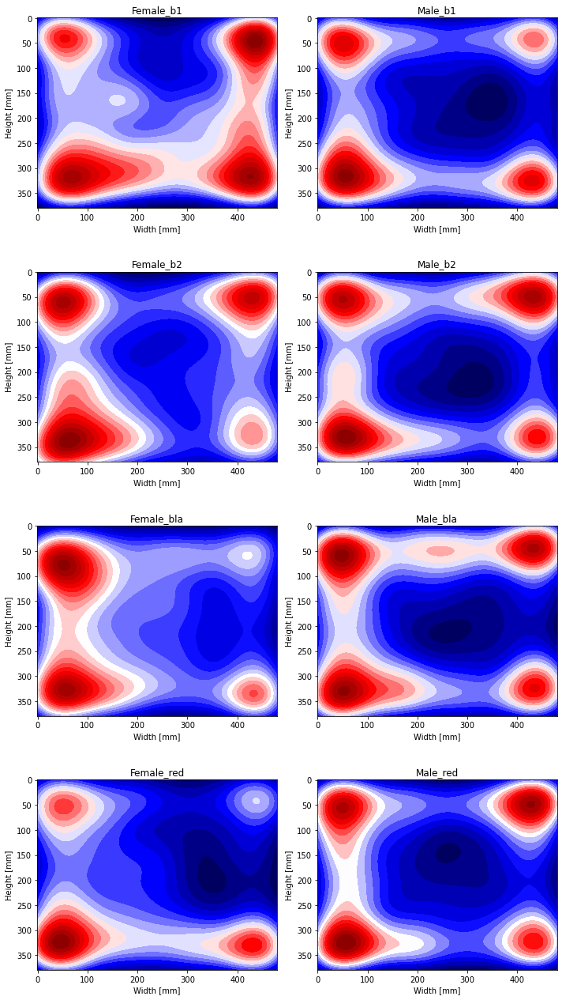

In [13]:
LEVELS = 20

for key in tqdm(result, position=0, leave=True, desc="Creating individual plots"):
    plt.imshow(corrected_frames[0]) # Corrects the shape
    treatment, sex = key
    plt.contourf(result[key].reshape(mgrid.shape[1:])[::1, ::1], cmap='seismic', alpha=1, levels=LEVELS)
    
    sex = 'Male' if sex == 'm' else 'Female'
    label = f"{sex}_{treatment}"
    plt.title(label)
    savepath = RESULTS / 'group-heatmaps' / f"{label}.png"
    if not savepath.parent.exists():
        savepath.parent.mkdir(parents=True)
    
    plt.ylabel("Height [mm]")
    plt.xlabel("Width [mm]")
    plt.savefig(savepath)
    plt.close()
    
plt.figure(figsize=(10, 18))
gs = plt.GridSpec(4, 2)
for idx, key in tqdm(enumerate(result), position=0, leave=True, desc="Creating summary plots"):
    plt.subplot(gs[idx])
    plt.imshow(corrected_frames[0]) # Corrects the shape
    treatment, sex = key
    plt.contourf(result[key].reshape(mgrid.shape[1:])[::1, ::1], cmap='seismic', alpha=1, levels=LEVELS)
    
    sex = 'Male' if sex == 'm' else 'Female'
    label = f"{sex}_{treatment}"
    plt.title(label)
    savepath = RESULTS / 'group-heatmaps' / f"{label}.png"
    if not savepath.parent.exists():
        savepath.parent.mkdir(parents=True)
    
    plt.ylabel("Height [mm]")
    plt.xlabel("Width [mm]")
    
plt.tight_layout()
plt.savefig(RESULTS / 'all-heatmaps.png')

## Time in Center Area

In [14]:
h, w = box_shape
s = 70

center_points = [
    [0+s, 0+s],
    [0+s, w-s],
    [h-s, w-s],
    [h-s, 0+s]
]

rows = []
for idx in tqdm(range(len(videos)), position=0, leave=True, desc="Creating individual plots"):
    video = videos[idx]
    M = homogeneous_transforms[idx]
    frame = corrected_frames[idx]
    
    df = get_df(video)
    df = remove_low_confidence_points(df)
    df = transform_dataframe_to_perspective(df, M)
    
    centroid = df.groupby(level='coords', axis=1).mean()[['x', 'y']]
    centroid = centroid.iloc[:CUTOFF_TIME] # Crop for time
    
    center_area = plt.Polygon(center_points, alpha=0.3)
    in_center = center_area.contains_points(centroid.values)
    
    plt.figure(figsize=(8,8))
    plt.imshow(frame)
    c = center_area.contains_points(centroid.values).astype(int)
    plt.scatter(centroid.x, centroid.y, c=c, s=1)
    plt.xlim(0, h)
    plt.ylim(0, w)
    plt.xlabel("Height [mm]")
    plt.ylabel("Width [mm]")
    plt.title(filename)
    plt.gca().add_patch(center_area)
    
    filename, ext = video.parts[-1].split('.')
    savepath = RESULTS / 'center-area-sizes' / f"{filename}.png"
    if not savepath.parent.exists():
        savepath.parent.mkdir()
    
    plt.savefig(savepath)
    
    m = re.match("g(?P<group>\d+)-(?P<treatment>\w+?)-.*", filename)
    rows.append({
        'id': filename,
        'time_in_center_area': round(np.sum(in_center) / 30, 2),
        **m.groupdict()
    })
    plt.close()

time_in_center = pd.DataFrame(rows)
time_in_center['sex'] = time_in_center.group.apply(lambda x: 'm' if int(x) <= 12 else 'f')
time_in_center.to_csv(RESULTS / 'time_in_center.csv', index=False)
time_in_center

Creating individual plots:   0%|          | 0/96 [00:00<?, ?it/s]

,id,time_in_center_area,group,treatment,sex
0,g19-b2-1,94.63,19,b2,f
1,g2-b1-1,86.90,2,b1,m
2,g13-b2-1,169.83,13,b2,f
3,g6-red-1,159.37,6,red,m
4,g8-b2-1,109.03,8,b2,m
...,...,...,...,...,...
91,g11-bla-1,236.37,11,bla,m
92,g12-b2-1,167.63,12,b2,m
93,g24-b1-1,163.50,24,b1,f
94,g12-red-1,115.07,12,red,m


Demonstrative image

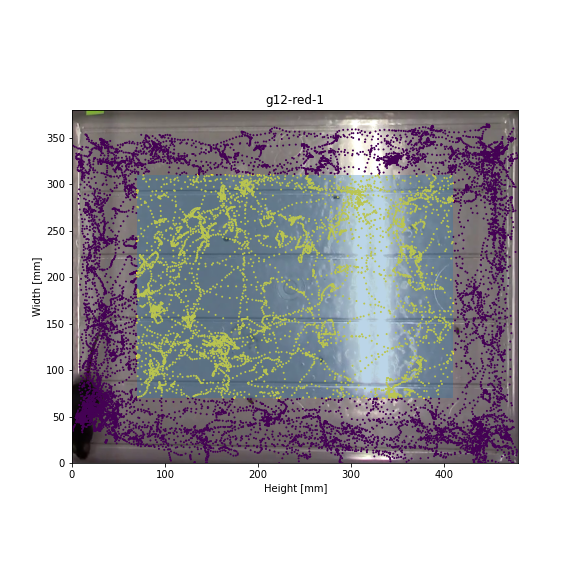

In [15]:
display(Image(savepath))

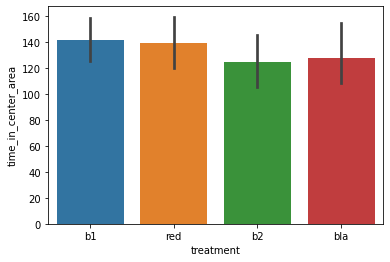

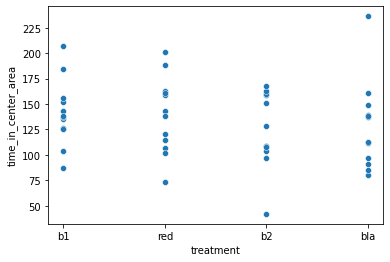

,sum_sq,df,F,PR(>F)
C(treatment),2388.584756,3.0,0.559588,0.644515
Residual,62604.249292,44.0,NaN,NaN


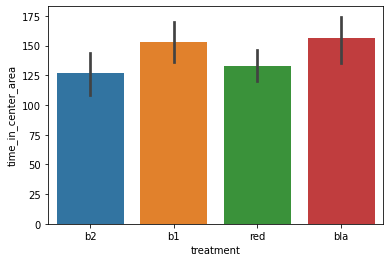

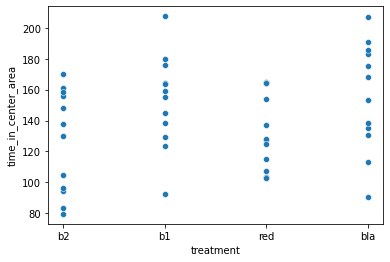

,sum_sq,df,F,PR(>F)
C(treatment),7597.011973,3.0,2.667466,0.059278
Residual,41771.043458,44.0,NaN,NaN


In [16]:
for sex in 'mf':
    if sex == 'm':
        display(HTML(f"<h2>Male</h2>"))
    else:
        display(HTML(f"<h2>Female</h2>"))
        
    sns.barplot(data=time_in_center[time_in_center.sex==sex], x='treatment', y='time_in_center_area')
    plt.show()
    sns.scatterplot(data=time_in_center[time_in_center.sex==sex], x='treatment', y='time_in_center_area')
    plt.show()
    model = ols('time_in_center_area ~ C(treatment)', data=time_in_center[time_in_center.sex==sex]).fit()
    aov_table = sm.stats.anova_lm(model, typ=2)
    display(aov_table)

## Immobility Time
Defined as < 5mm per second

In [17]:
speed_per_second = 10 # in mm
speed = speed_per_second / config['fps']

rows = []
for idx in tqdm(range(len(videos))):
    M = homogeneous_transforms[idx]
    frame = corrected_frames[idx]
    df = get_df(video)
    df = remove_low_confidence_points(df)
    df = transform_dataframe_to_perspective(df, M)
    
    centroid = df.groupby(level='coords', axis=1).mean()[['x', 'y']]
    centroid = centroid.iloc[:CUTOFF_TIME] # Crop for time
    # centroid = centroid.rolling(30).mean()
    deltas = centroid.diff().dropna()
    immobile = np.sum(np.linalg.norm(deltas.values, axis=1) < speed)
    
    filename, ext = videos[idx].parts[-1].split('.')
    
    m = re.match("g(?P<group>\d+)-(?P<treatment>\w+?)-.*", filename)
    
    rows.append({
        'id': filename,
        'immobile': immobile / config['fps'],
        **m.groupdict()
    })
    
immobile = pd.DataFrame(rows)
immobile['sex'] = immobile.group.apply(lambda x: 'm' if int(x) <= 12 else 'f')
immobile.to_csv(RESULTS / 'immobile.csv', index=False)
immobile

  0%|          | 0/96 [00:00<?, ?it/s]

,id,immobile,group,treatment,sex
0,g19-b2-1,48.033333,19,b2,f
1,g2-b1-1,81.833333,2,b1,m
2,g13-b2-1,53.433333,13,b2,f
3,g6-red-1,80.733333,6,red,m
4,g8-b2-1,83.200000,8,b2,m
...,...,...,...,...,...
91,g11-bla-1,53.666667,11,bla,m
92,g12-b2-1,53.266667,12,b2,m
93,g24-b1-1,48.300000,24,b1,f
94,g12-red-1,53.566667,12,red,m


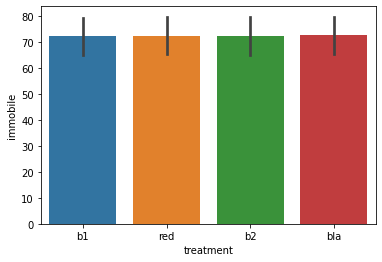

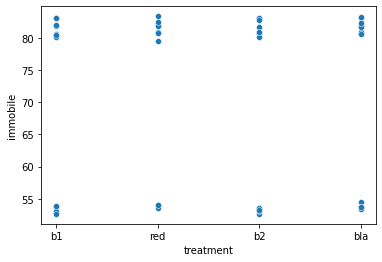

,sum_sq,df,F,PR(>F)
C(treatment),1.274907,3.0,0.0022,0.999855
Residual,8501.055370,44.0,NaN,NaN


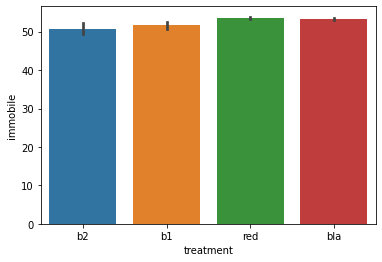

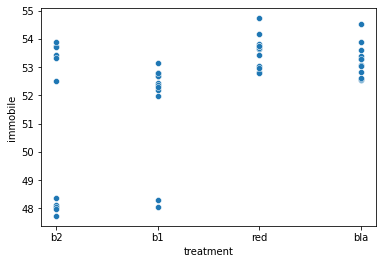

,sum_sq,df,F,PR(>F)
C(treatment),60.918032,3.0,6.909146,0.000652
Residual,129.316204,44.0,NaN,NaN


In [18]:
for sex in 'mf':
    if sex == 'm':
        display(HTML(f"<h2>Male</h2>"))
    else:
        display(HTML(f"<h2>Female</h2>"))
        
    sns.barplot(data=immobile[immobile.sex==sex], x='treatment', y='immobile')
    plt.show()
    sns.scatterplot(data=immobile[immobile.sex==sex], x='treatment', y='immobile')
    plt.show()
    model = ols('immobile ~ C(treatment)', data=immobile[immobile.sex==sex]).fit()
    aov_table = sm.stats.anova_lm(model, typ=2)
    display(aov_table)